In [2]:
from dataloader_230414 import N2N_F01_Dataset
from torch.utils.data import DataLoader
        

/home/hyunwoong/miniconda3/envs/GAN_n2n/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
tr_data_loader = N2N_F01_Dataset()
tr_data_loader = DataLoader(tr_data_loader, batch_size=4, shuffle=True, num_workers=0, drop_last=True)


(1, 256, 256) [[0.6392157  0.34509805 0.85882354 ... 0.9764706  1.         0.80784315]
 [0.5137255  0.81960785 0.75686276 ... 0.53333336 0.3647059  0.2901961 ]
 [0.6901961  0.9764706  0.3764706  ... 0.4392157  0.5058824  0.88235295]
 ...
 [0.5647059  0.5686275  0.19607843 ... 0.39607844 0.68235296 0.48235294]
 [0.8235294  0.72156864 0.41960785 ... 0.3019608  0.08627451 0.42352942]
 [0.5019608  0.46666667 0.88235295 ... 0.6509804  0.41960785 0.9529412 ]] [[0.6392157  0.34509805 0.85882354 ... 0.9764706  1.         0.80784315]
 [0.5137255  0.81960785 0.75686276 ... 0.53333336 0.3647059  0.2901961 ]
 [0.6901961  0.9764706  0.3764706  ... 0.4392157  0.5058824  0.88235295]
 ...
 [0.5647059  0.5686275  0.19607843 ... 0.39607844 0.68235296 0.48235294]
 [0.8235294  0.72156864 0.41960785 ... 0.3019608  0.08627451 0.42352942]
 [0.5019608  0.46666667 0.88235295 ... 0.6509804  0.41960785 0.9529412 ]]
(1, 256, 256) [[0.4745098  0.23529412 0.2901961  ... 0.6862745  0.3372549  0.63529414]
 [0.7607843

In [4]:
import sys
import matplotlib.pyplot as plt

for batch_idx, (noisy1,noisy2, clean) in enumerate(tr_data_loader):
    
    source = noisy1.cuda()
    target = noisy2.cuda()
    print(source.shape)
    plt.subplot(1,3,1)
    plt.imshow(source[0,0].cpu().numpy(),cmap='gray')
    plt.subplot(1,3,2)
    plt.imshow(target[0,0].cpu().numpy(),cmap='gray')
    plt.subplot(1,3,3)
    plt.imshow(clean[0,0].cpu().numpy(),cmap='gray')
    
    sys.exit(0)    

ValueError: At least one stride in the given numpy array is negative, and tensors with negative strides are not currently supported. (You can probably work around this by making a copy of your array  with array.copy().) 

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
{'img_name': ['F01_25'], 'img_idx': tensor([0]), 'pair_idx': tensor([0])}


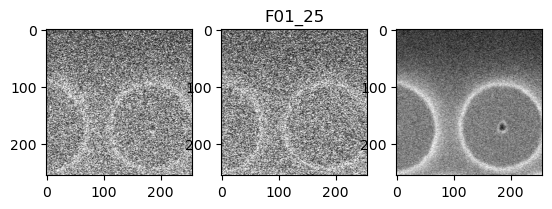

In [11]:
import sys
import cv2
import matplotlib.pyplot as plt
%load_ext autoreload
%autoreload 2
te_data_loader =  N2N_F01_Dataset(data_path = "/mnt/ssd/hyun/fbi-net/FBI-Denoiser/data/test_Samsung_SNU_patches_230414.hdf5", return_img_info = True)
te_data_loader = DataLoader(te_data_loader, batch_size=1, shuffle=False, num_workers=0, drop_last=False)
         
for batch_idx, (img_info,noisy1,noisy2, clean) in enumerate(te_data_loader):
    
    source = noisy1.cuda()
    target = noisy2.cuda()
    print(img_info)
    plt.subplot(1,3,1)
    plt.imshow(source[0,0].cpu().numpy(),cmap='gray')
    plt.subplot(1,3,2)
    plt.title(f"{img_info['img_name'][0]}")
    plt.imshow(target[0,0].cpu().numpy(),cmap='gray')
    plt.subplot(1,3,3)
    plt.imshow(clean[0,0].cpu().numpy(),cmap='gray')
    tmp = target[0][0].cpu().numpy()*255
    cv2.imwrite("test_target.png",tmp)
    break  

In [12]:
source[0][0].cpu().numpy()*255

array([[ 31.,  65.,  76., ..., 183., 139., 139.],
       [104., 122.,  19., ..., 129., 174., 209.],
       [100., 101., 158., ...,  35.,  74., 113.],
       ...,
       [239.,  83., 228., ..., 144., 157., 149.],
       [174., 118., 188., ..., 107., 166., 130.],
       [255., 243., 168., ..., 115., 118., 208.]], dtype=float32)

(256, 256, 3)


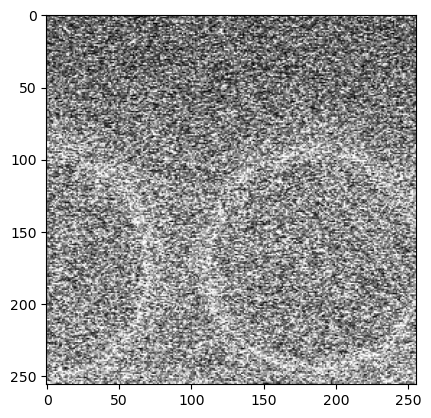

In [15]:
import cv2
import numpy as np

a = cv2.imread("./test_target.png")
print(a.shape)
plt.imshow(a)